# EDA: QRISP Dataset for Image Super-Resolution

## Introduction

This notebook performs exploratory data analysis on the QRISP dataset for super-resolution modeling. 

Exploring: 

1. **Resolution Variability** - Identify the range of image resolutions and scale factors
2. **Processing Techniques** - Compare different image processing methods (Native, MipBias, Jittered)

In [40]:
import os
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import math
import pandas as pd
import seaborn as sns
pd.set_option('display.max_rows', None)

## Setup Paths

In [41]:
current_dir = os.getcwd()
qrisp_path = os.path.join(current_dir, '..', 'data', 'QRISP')
test_set_path = os.path.join(qrisp_path, 'TestSet')

RESOLUTIONS = ["270p", "360p", "540p", "1080p"]
PROCESSING_TYPES = ["Native", "MipBiasMinus2", "MipBiasMinus2Jittered","DepthMipBiasMinus2", "DepthMipBiasMinus2Jittered", "MotionVectorsMipBiasMinus2", "MotionVectorsMipBiasMinus2Jittered" ]

## Define Functions

In [42]:
def find_images(directory):
    """Find all image files in a directory recursively"""
    images = []
    if os.path.exists(directory):
        for root, _, files in os.walk(directory):
            for file in files:
                if file.lower().endswith(('.png', '.jpg', '.jpeg')):
                    images.append(os.path.join(root, file))
    return sorted(images)

def get_image_id(file_path):
    """Extract image ID from file path"""
    filename = os.path.basename(file_path)
    return os.path.splitext(filename)[0]

def get_available_scenes():
    """Get list of all available scenes in the dataset"""
    try:
        main_scenes = [d for d in os.listdir(qrisp_path) 
                     if os.path.isdir(os.path.join(qrisp_path, d)) and d != 'TestSet']
        
        test_scenes = []
        if os.path.exists(test_set_path):
            test_scenes = [os.path.join('TestSet', d) for d in os.listdir(test_set_path)
                         if os.path.isdir(os.path.join(test_set_path, d))]
        
        return sorted(main_scenes + test_scenes)
    except Exception as e:
        print(f"Error reading scenes directory: {e}")
        return ["CBApocalypse"]  # default scene

## Dataset Overview


Total dataset composition:


,Scene,Resolution,Processing,Image Count,Width,Height,Scene_Type
80,TestSet\AbandonedSchool,270p,Native,600,480,270,TestSet
81,TestSet\AbandonedSchool,270p,MipBiasMinus2,600,480,270,TestSet
82,TestSet\AbandonedSchool,270p,MipBiasMinus2Jittered,600,480,270,TestSet
83,TestSet\AbandonedSchool,270p,DepthMipBiasMinus2,600,480,270,TestSet
84,TestSet\AbandonedSchool,270p,DepthMipBiasMinus2Jittered,600,480,270,TestSet
85,TestSet\AbandonedSchool,360p,Native,600,640,360,TestSet
86,TestSet\AbandonedSchool,540p,Native,600,960,540,TestSet
87,TestSet\AbandonedSchool,1080p,Native,600,1920,1080,TestSet
88,TestSet\SeaPort,270p,Native,300,480,270,TestSet
89,TestSet\SeaPort,270p,MipBiasMinus2,300,480,270,TestSet



Images per resolution:


,Image Count
Resolution,
1080p,8760
270p,43800
360p,8760
540p,8760



Images by dataset type:


,Image Count
Scene_Type,
TestSet,12000
Train,58080


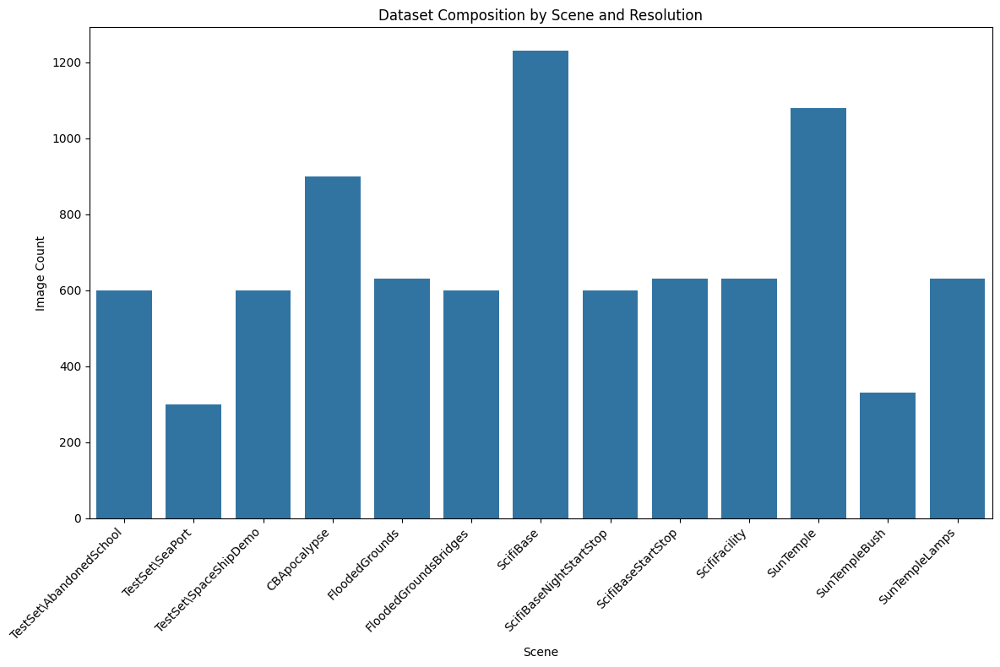

In [43]:
available_scenes = get_available_scenes()
dataset_stats = []

for i, scene in enumerate(available_scenes):
    
    if scene.startswith('TestSet/'):
        scene_path = os.path.join(qrisp_path, scene)
    else:
        scene_path = os.path.join(qrisp_path, scene)
    
    for res in RESOLUTIONS:
        for proc in PROCESSING_TYPES:
            folder_path = os.path.join(scene_path, res, proc)
            if not os.path.exists(folder_path):
                continue
                
            files = find_images(folder_path)
            if not files:
                continue
                
            try:
                img = Image.open(files[0])
                width, height = img.size
                img.close()
            except:
                width, height = 0, 0
                
            dataset_stats.append({
                'Scene': scene,
                'Resolution': res,
                'Processing': proc,
                'Image Count': len(files),
                'Width': width,
                'Height': height
            })

stats_df = pd.DataFrame(dataset_stats)

stats_df['Scene_Type'] = stats_df['Scene'].apply(lambda x: 'TestSet' if 'TestSet' in x else 'Train')
stats_df = stats_df.sort_values(['Scene_Type', 'Scene'])

print(f"\nTotal dataset composition:")
display(stats_df)

res_summary = stats_df.groupby('Resolution')[['Image Count']].sum()
print("\nImages per resolution:")
display(res_summary)

type_summary = stats_df.groupby('Scene_Type')[['Image Count']].sum()
print("\nImages by dataset type:")
display(type_summary)

plt.figure(figsize=(12, 8))
sns.barplot(data=stats_df, x='Scene', y='Image Count')
plt.title('Dataset Composition by Scene and Resolution')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

## Resolution Analysis
The resolution analysis is a crucial step in developing super-resolution models. By examining different resolutions in our QRISP dataset, we can:

* Determine exact scale factors between resolution pairs (e.g., 270p to 1080p), which is essential for model architecture design
* Verify consistency of upscaling ratios across different scenes
* Visualize quality differences between resolution levels to understand what details need to be reconstructed

## Scale Factors
The scale factor is important for several reasons:
* **Training**: Models are typically trained to upscale images by a specific factor (2x, 4x etc)
* **Performance evaluation**: Different upscaling factors represent different levels of difficulty - a higher scale factor (like 8x) is generally more challenging than a lower one (like 2x)
* **Application requirements**: Some applications might need specific upscaling factors depending on the target display resolution


Comparing resolutions for scene: CBApocalypse (Processing: Native)
  270p: 900 images
  360p: 900 images
  540p: 900 images
  1080p: 900 images
  Found 30 matching image pairs across resolutions


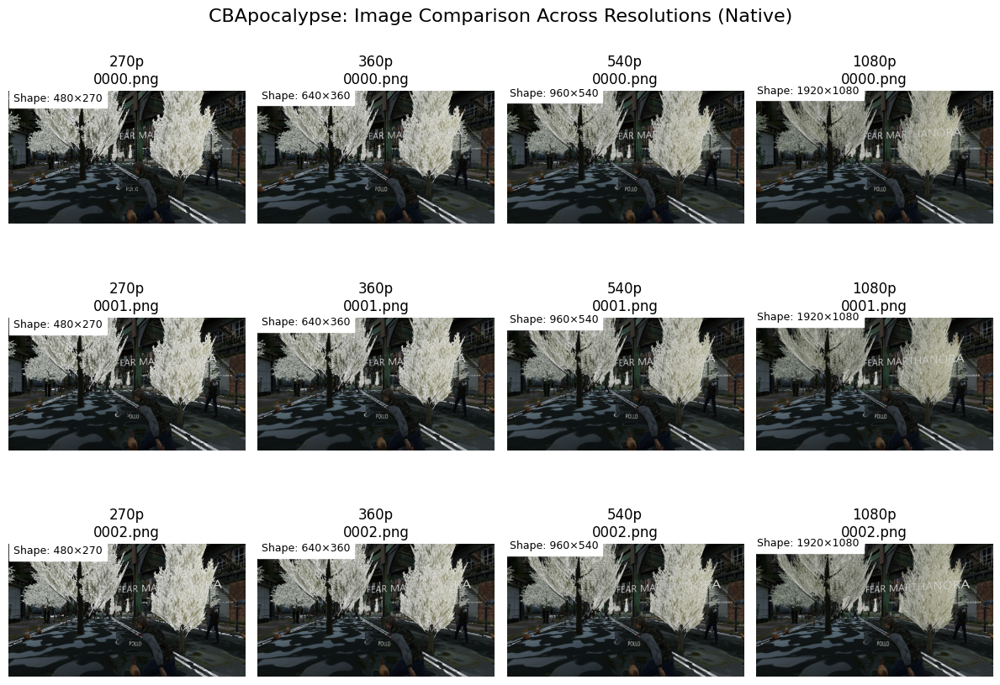


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00


In [44]:
def compare_resolution_scales(scene_name, processing_type="Native"):
    """Compare images across different resolutions and calculate scale factors"""
    scene_path = os.path.join(qrisp_path, scene_name)
    resolution_paths = {res: os.path.join(scene_path, res, processing_type) for res in RESOLUTIONS}
    
    resolution_files = {res: find_images(path) for res, path in resolution_paths.items() if os.path.exists(path)}
    available_resolutions = [res for res in RESOLUTIONS if res in resolution_files and resolution_files[res]]
    
    if len(available_resolutions) < 2:
        print(f"Not enough resolutions available for scene {scene_name} with processing {processing_type}")
        return
    
    print(f"\nComparing resolutions for scene: {scene_name} (Processing: {processing_type})")
    for res in available_resolutions:
        print(f"  {res}: {len(resolution_files[res])} images")
    
    resolution_dicts = {res: {get_image_id(f): f for f in files} 
                       for res, files in resolution_files.items()}
    
    common_ids = set(resolution_dicts[available_resolutions[0]].keys())
    for res in available_resolutions[1:]:
        common_ids &= set(resolution_dicts[res].keys())
    common_ids = sorted(common_ids)
    
    print(f"  Found {len(common_ids)} matching image pairs across resolutions")
    
    if not common_ids:
        return
    
    num_samples = min(3, len(common_ids))
    fig, axes = plt.subplots(num_samples, len(available_resolutions), figsize=(3*len(available_resolutions), 3*num_samples))
    
    if num_samples == 1:
        axes = np.array([axes])
    
    for i in range(num_samples):
        image_id = common_ids[i]
        
        for j, res in enumerate(available_resolutions):
            img_path = resolution_dicts[res][image_id]
            img = np.array(Image.open(img_path))
            
            axes[i, j].imshow(img)
            axes[i, j].set_title(f"{res}\n{image_id}.png")
            axes[i, j].axis('off')
            
            axes[i, j].text(10, 20, f"Shape: {img.shape[1]}×{img.shape[0]}", 
                           backgroundcolor='white', fontsize=9)

    plt.suptitle(f"{scene_name}: Image Comparison Across Resolutions ({processing_type})", fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    plt.show()
    
    base_res = available_resolutions[0]
    base_image = resolution_dicts[base_res][common_ids[0]]
    base_shape = np.array(Image.open(base_image)).shape
    
    scale_factors = []
    for res in available_resolutions:
        img_path = resolution_dicts[res][common_ids[0]]
        img_shape = np.array(Image.open(img_path)).shape
        scale_h = img_shape[0] / base_shape[0]
        scale_w = img_shape[1] / base_shape[1]
        scale_factors.append({
            'Resolution': res,
            'Height': img_shape[0],
            'Width': img_shape[1],
            'Scale Factor': round(scale_h, 2),
            'Height Scale': round(scale_h, 2),
            'Width Scale': round(scale_w, 2)
        })
    
    scale_df = pd.DataFrame(scale_factors)
    print(f"\nScale factors (relative to {base_res}):")
    display(scale_df)
    
    return scale_df

sample_scene = available_scenes[0]  # Use first available scene
compare_resolution_scales(sample_scene)

### Analyze All Scene Scale Factors

Analyzing scenes...

Comparing resolutions for scene: CBApocalypse (Processing: Native)
  270p: 900 images
  360p: 900 images
  540p: 900 images
  1080p: 900 images
  Found 30 matching image pairs across resolutions


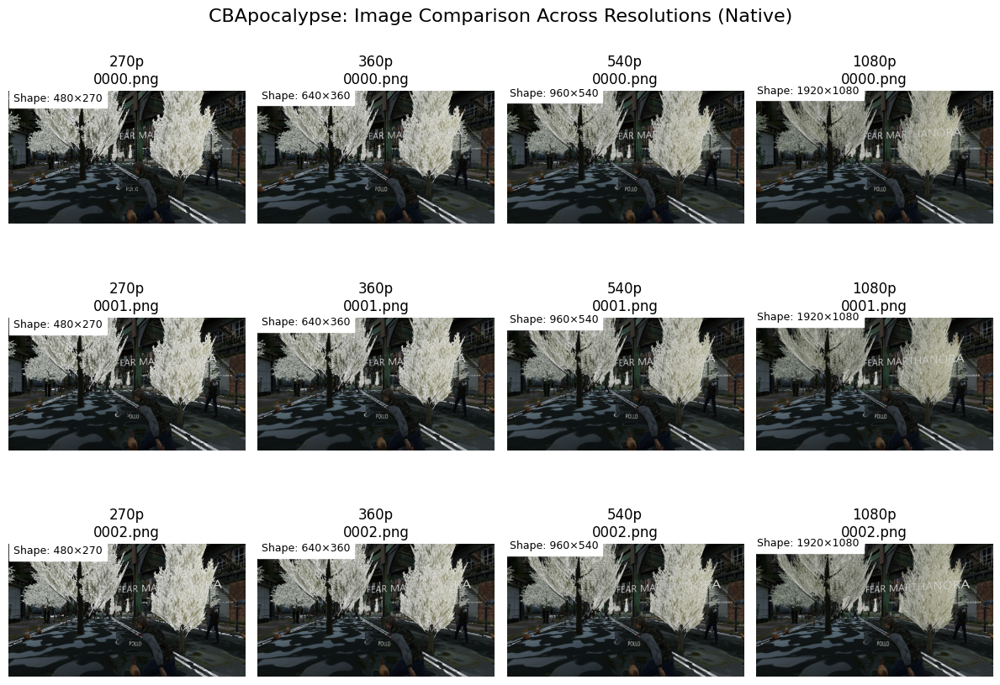


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: FloodedGrounds (Processing: Native)
  270p: 630 images
  360p: 630 images
  540p: 630 images
  1080p: 630 images
  Found 30 matching image pairs across resolutions


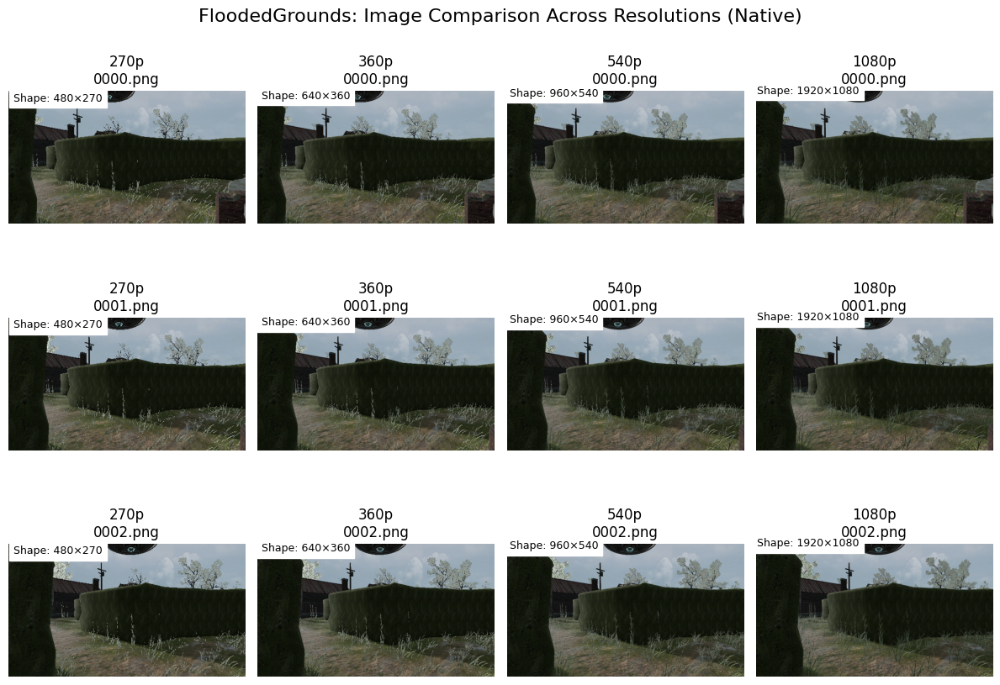


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: FloodedGroundsBridges (Processing: Native)
  270p: 600 images
  360p: 600 images
  540p: 600 images
  1080p: 600 images
  Found 30 matching image pairs across resolutions


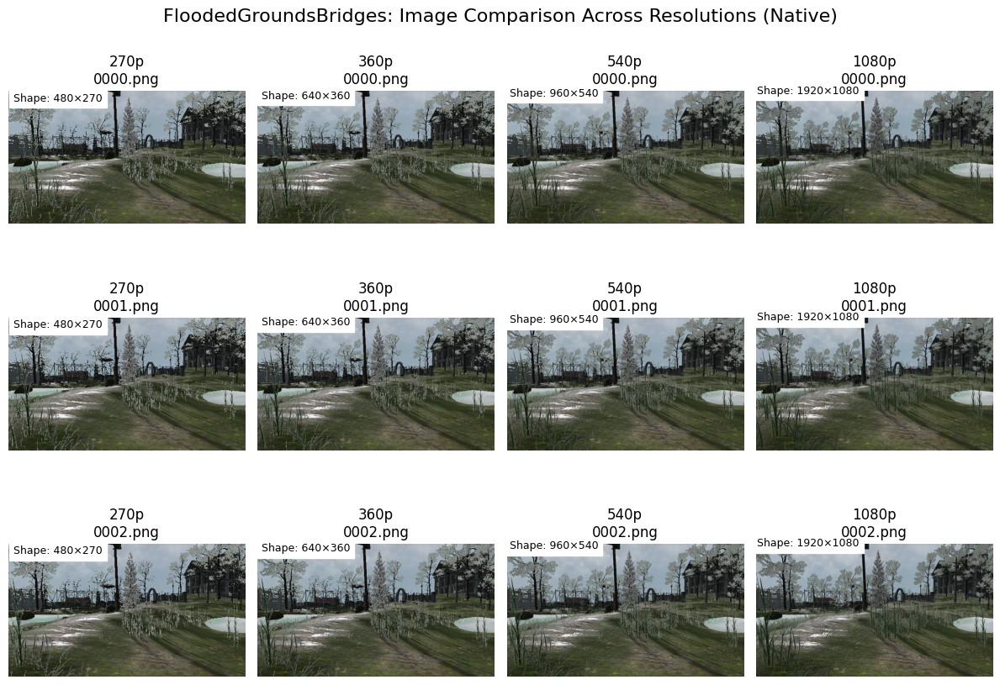


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: ScifiBase (Processing: Native)
  270p: 1230 images
  360p: 1230 images
  540p: 1230 images
  1080p: 1230 images
  Found 30 matching image pairs across resolutions


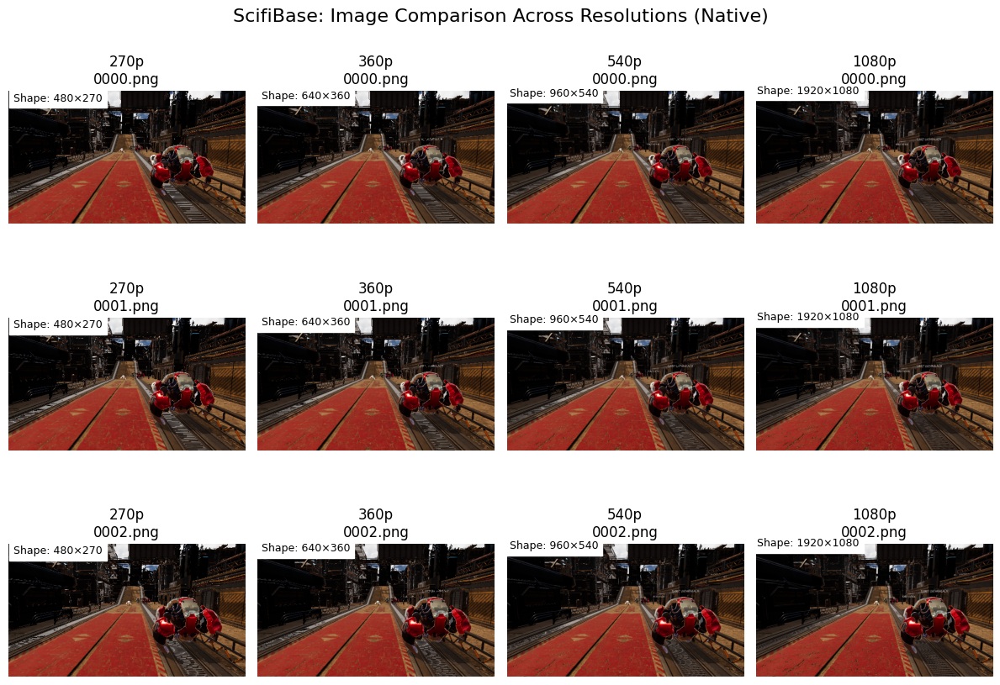


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: ScifiBaseNightStartStop (Processing: Native)
  270p: 600 images
  360p: 600 images
  540p: 600 images
  1080p: 600 images
  Found 30 matching image pairs across resolutions


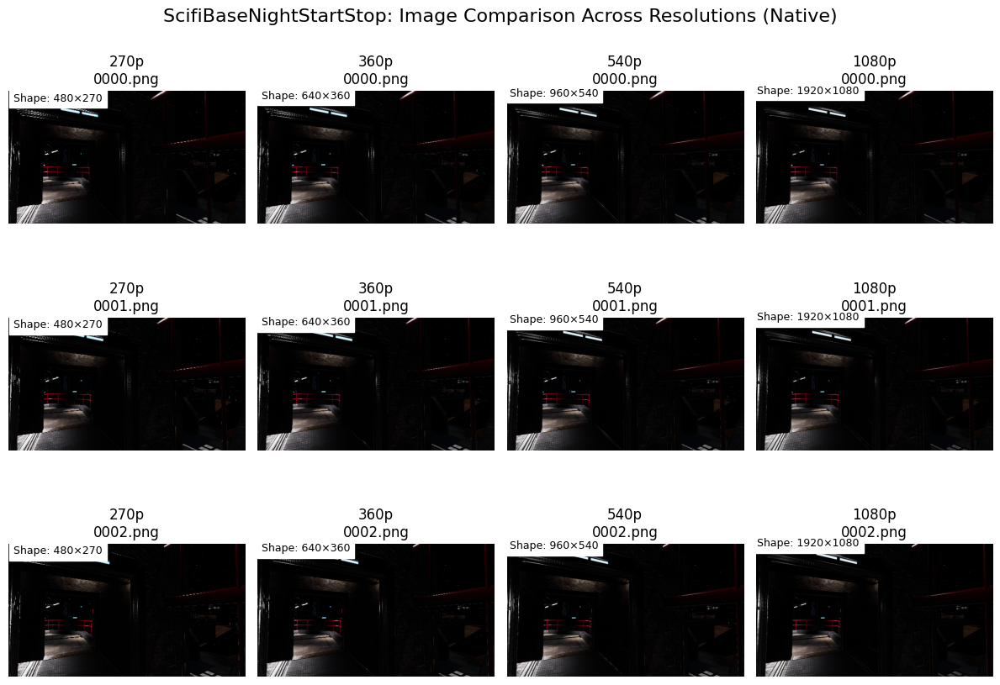


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: ScifiBaseStartStop (Processing: Native)
  270p: 630 images
  360p: 630 images
  540p: 630 images
  1080p: 630 images
  Found 30 matching image pairs across resolutions


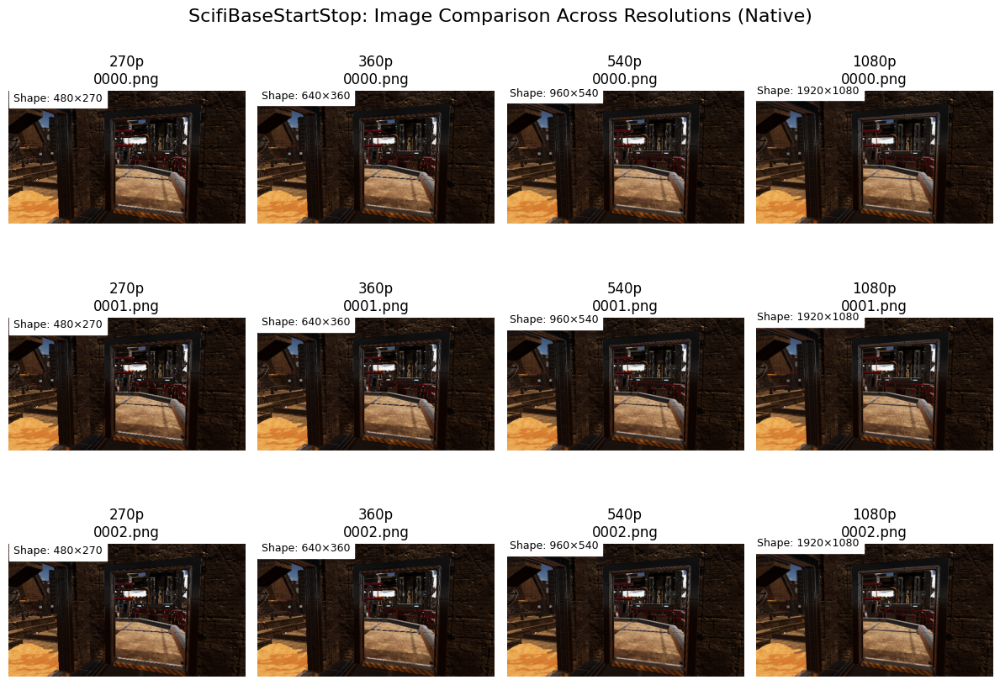


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: ScifiFacility (Processing: Native)
  270p: 630 images
  360p: 630 images
  540p: 630 images
  1080p: 630 images
  Found 30 matching image pairs across resolutions


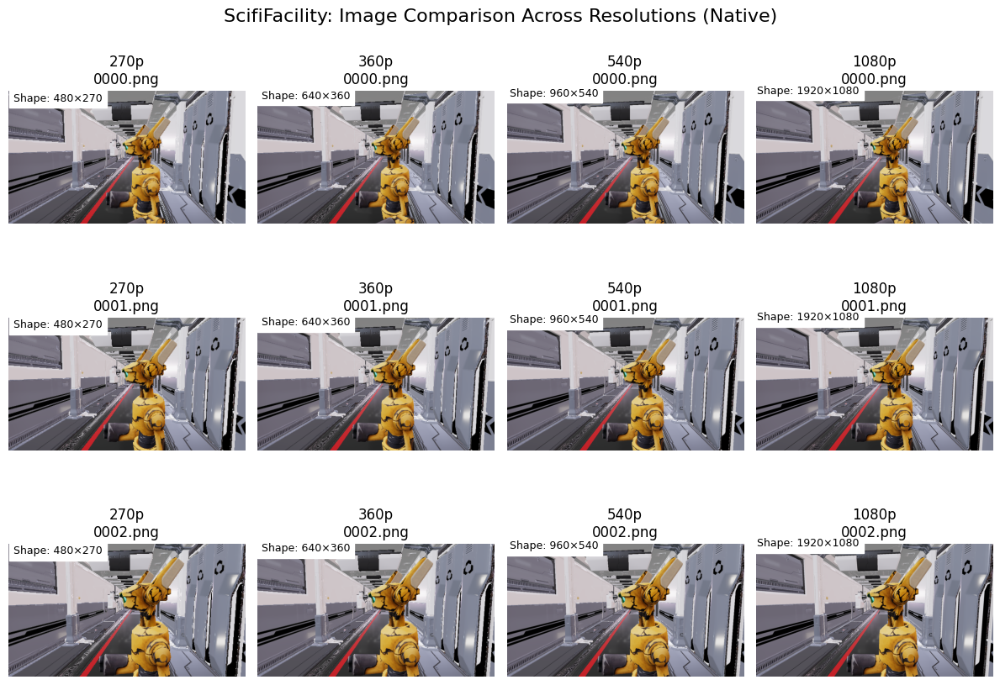


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: SunTemple (Processing: Native)
  270p: 1080 images
  360p: 1080 images
  540p: 1080 images
  1080p: 1080 images
  Found 30 matching image pairs across resolutions


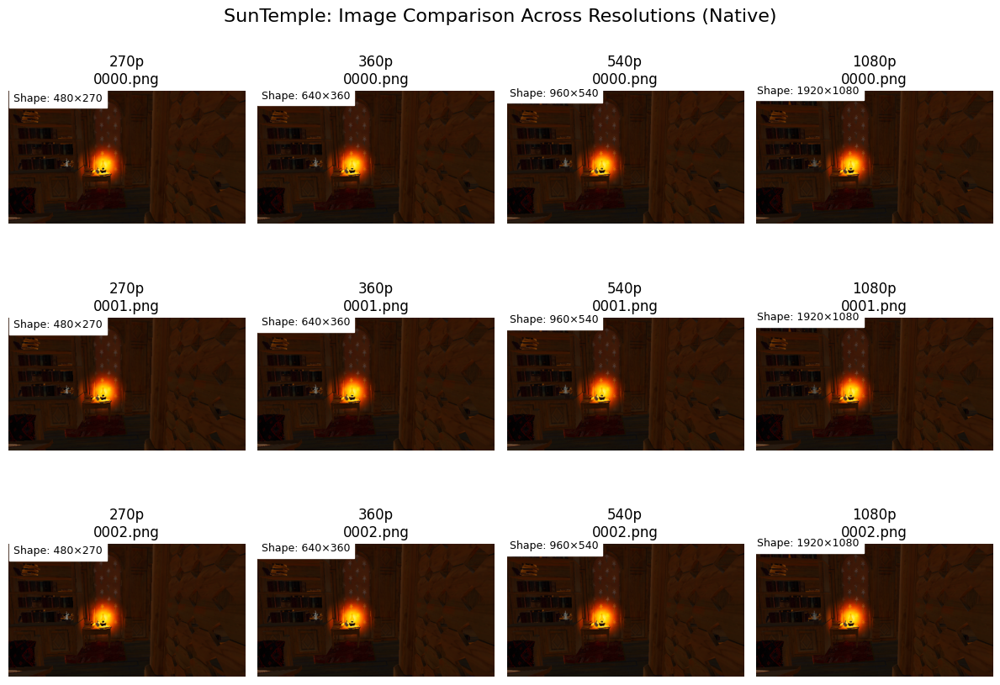


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: SunTempleBush (Processing: Native)
  270p: 330 images
  360p: 330 images
  540p: 330 images
  1080p: 330 images
  Found 30 matching image pairs across resolutions


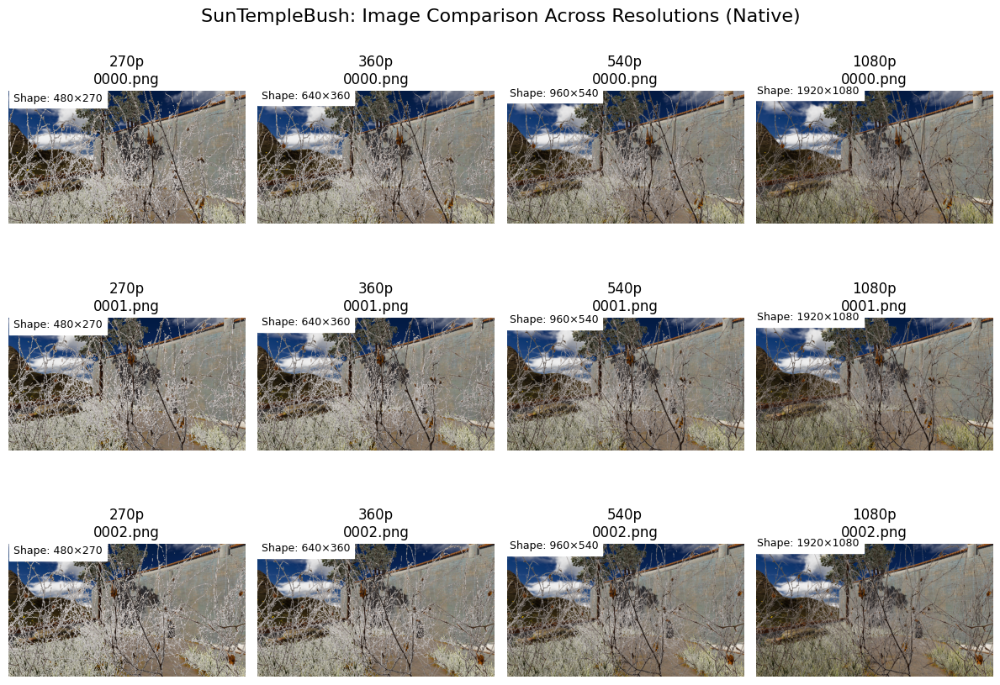


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: SunTempleLamps (Processing: Native)
  270p: 630 images
  360p: 630 images
  540p: 630 images
  1080p: 630 images
  Found 30 matching image pairs across resolutions


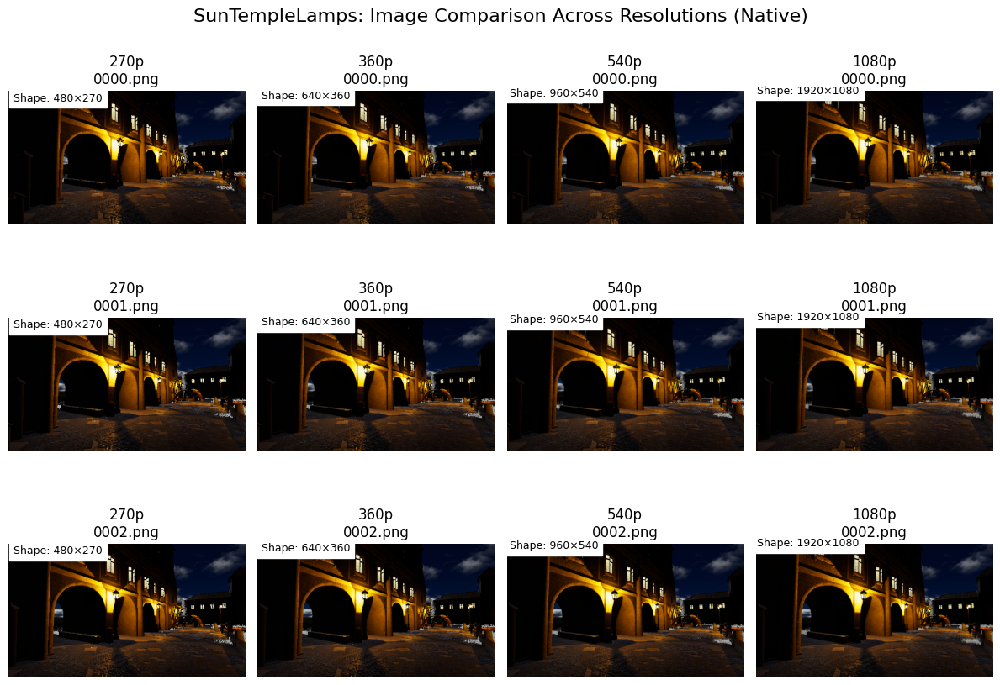


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: TestSet\AbandonedSchool (Processing: Native)
  270p: 600 images
  360p: 600 images
  540p: 600 images
  1080p: 600 images
  Found 300 matching image pairs across resolutions


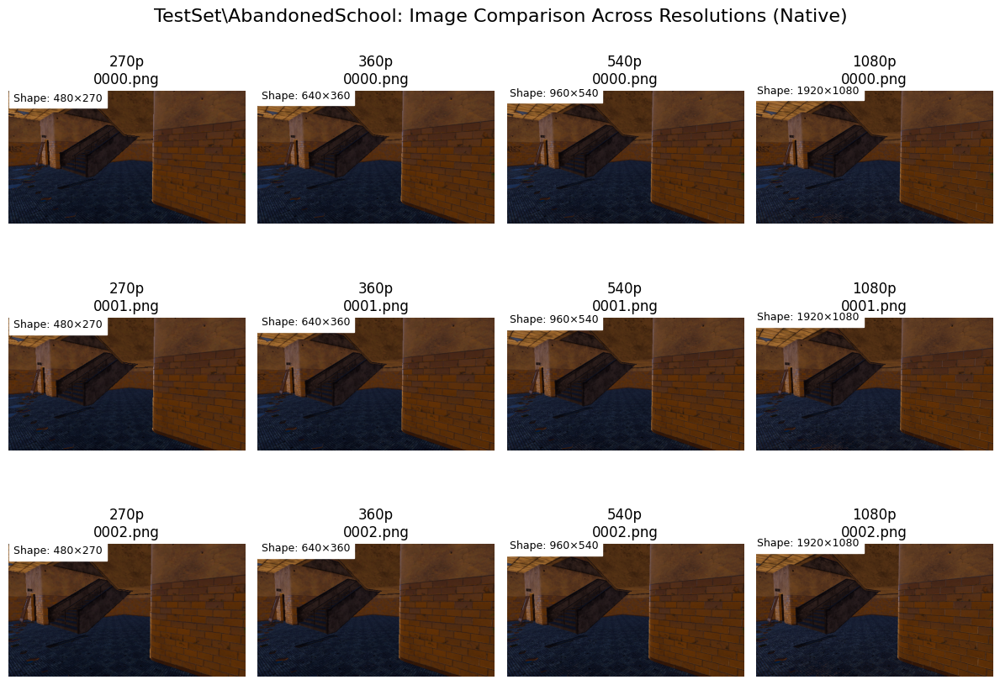


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: TestSet\SeaPort (Processing: Native)
  270p: 300 images
  360p: 300 images
  540p: 300 images
  1080p: 300 images
  Found 300 matching image pairs across resolutions


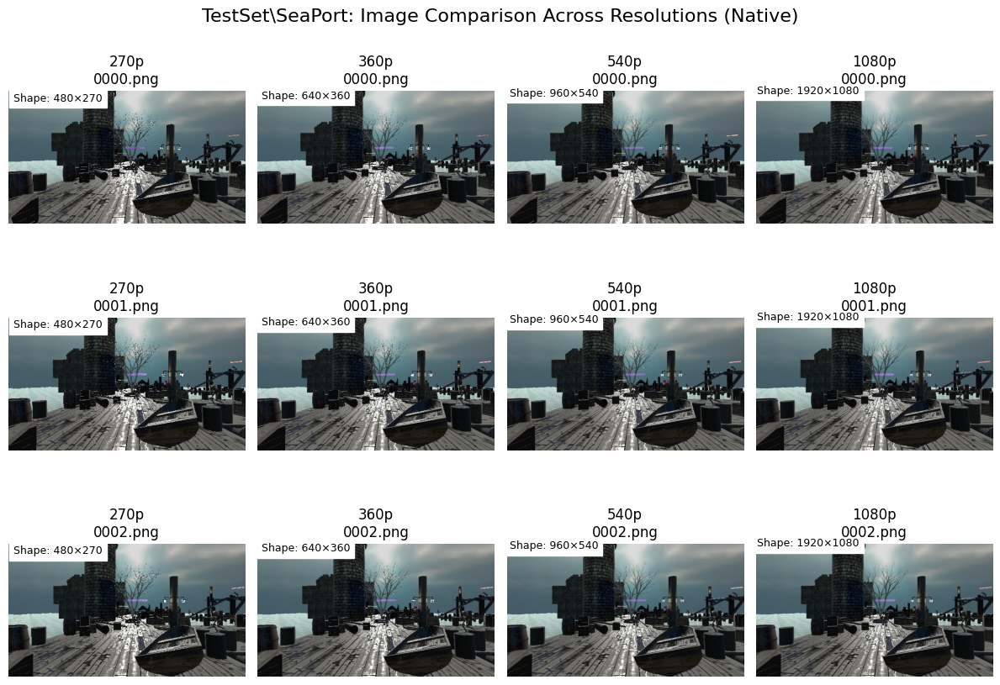


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Comparing resolutions for scene: TestSet\SpaceShipDemo (Processing: Native)
  270p: 600 images
  360p: 600 images
  540p: 600 images
  1080p: 600 images
  Found 300 matching image pairs across resolutions


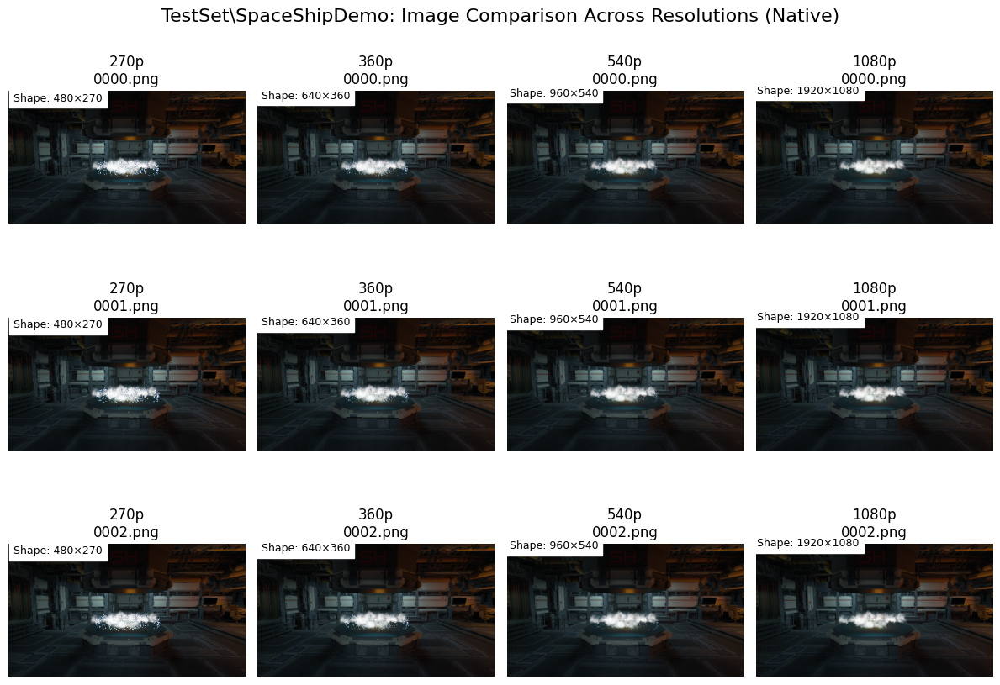


Scale factors (relative to 270p):


,Resolution,Height,Width,Scale Factor,Height Scale,Width Scale
0,270p,270,480,1.00,1.00,1.00
1,360p,360,640,1.33,1.33,1.33
2,540p,540,960,2.00,2.00,2.00
3,1080p,1080,1920,4.00,4.00,4.00



Average scale factors across all scenes:


,Scale Factor,Height,Width
Resolution,,,
1080p,4.00,1080.0,1920.0
270p,1.00,270.0,480.0
360p,1.33,360.0,640.0
540p,2.00,540.0,960.0


In [45]:
all_scale_factors = []

print("Analyzing scenes...")
for i, scene in enumerate(available_scenes):
    scale_df = compare_resolution_scales(scene, processing_type="Native")
    if scale_df is not None:
        scale_df['Scene'] = scene
        all_scale_factors.append(scale_df)

if all_scale_factors:
    combined_scale_df = pd.concat(all_scale_factors, ignore_index=True)
    
    summary = combined_scale_df.groupby('Resolution')[['Scale Factor', 'Height', 'Width']].mean()
    print("\nAverage scale factors across all scenes:")
    display(summary)

## Processing Technique Comparison

* Native image - unmodified, unprocessed images (baseline reference). 
* Mipmap biasing - texture filtering technique to improve rendering quality and performance. 
* Jittering - adds controlled randomness to sampling positions to reduce aliasing artifacts (visual distortions like jagged edges or wavy textures) producing more natural looking results.  
* Additional modalities include motion vectors and depth info. 


In [46]:
def compare_processing_techniques(scene_names, resolution="270p"):
    """Compare different processing techniques for multiple scenes at the same resolution"""
    
    # Convert single scene to list if needed
    if isinstance(scene_names, str):
        scene_names = [scene_names]
    
    all_metrics = []
    
    for scene_name in scene_names:
        print(f"\n{'-'*50}")
        print(f"Analyzing scene: {scene_name}")
        scene_path = os.path.join(qrisp_path, scene_name)
        
        # Check which processing techniques are available for this scene/resolution
        available_procs = []
        proc_paths = {}
        
        for proc in PROCESSING_TYPES:
            path = os.path.join(scene_path, resolution, proc)
            if os.path.exists(path):
                files = find_images(path)
                if files:
                    available_procs.append(proc)
                    proc_paths[proc] = path
        
        if len(available_procs) < 2:
            print(f"Not enough processing techniques available for scene {scene_name} at resolution {resolution}")
            continue
        
        print(f"Comparing processing techniques for scene: {scene_name} (Resolution: {resolution})")
        
        # Find images for each processing technique
        proc_files = {proc: find_images(path) for proc, path in proc_paths.items()}
        for proc in available_procs:
            print(f"  {proc}: {len(proc_files[proc])} images")
        
        # Group images by ID
        proc_dicts = {proc: {get_image_id(f): f for f in files} 
                     for proc, files in proc_files.items()}
        
        # Find common IDs across all processing techniques
        common_ids = set(proc_dicts[available_procs[0]].keys())
        for proc in available_procs[1:]:
            common_ids &= set(proc_dicts[proc].keys())
        common_ids = sorted(common_ids)
        
        print(f"  Found {len(common_ids)} matching image pairs across processing techniques")
        
        if not common_ids:
            continue
        
        # Display a sample of images (up to 3)
        num_samples = min(3, len(common_ids))
        fig, axes = plt.subplots(num_samples, len(available_procs), figsize=(4*len(available_procs), 4*num_samples))
        
        # Make axes 2D even with one sample
        if num_samples == 1:
            axes = np.array([axes])
        
        for i in range(num_samples):
            image_id = common_ids[i]
            
            for j, proc in enumerate(available_procs):
                # Load image
                img_path = proc_dicts[proc][image_id]
                img = np.array(Image.open(img_path))
                
                # Display image
                axes[i, j].imshow(img)
                axes[i, j].set_title(f"{proc}\n{image_id}.png")
                axes[i, j].axis('off')
                
                # Add shape info
                axes[i, j].text(10, 20, f"Shape: {img.shape[1]}×{img.shape[0]}", 
                               backgroundcolor='white', fontsize=9)

        plt.suptitle(f"{scene_name} ({resolution}): Comparison of Processing Techniques", fontsize=16)
        plt.tight_layout()
        plt.subplots_adjust(top=0.95)
        plt.show()


--------------------------------------------------
Analyzing scene: CBApocalypse
Comparing processing techniques for scene: CBApocalypse (Resolution: 270p)
  Native: 900 images
  MipBiasMinus2: 900 images
  MipBiasMinus2Jittered: 900 images
  DepthMipBiasMinus2: 900 images
  DepthMipBiasMinus2Jittered: 900 images
  Found 30 matching image pairs across processing techniques


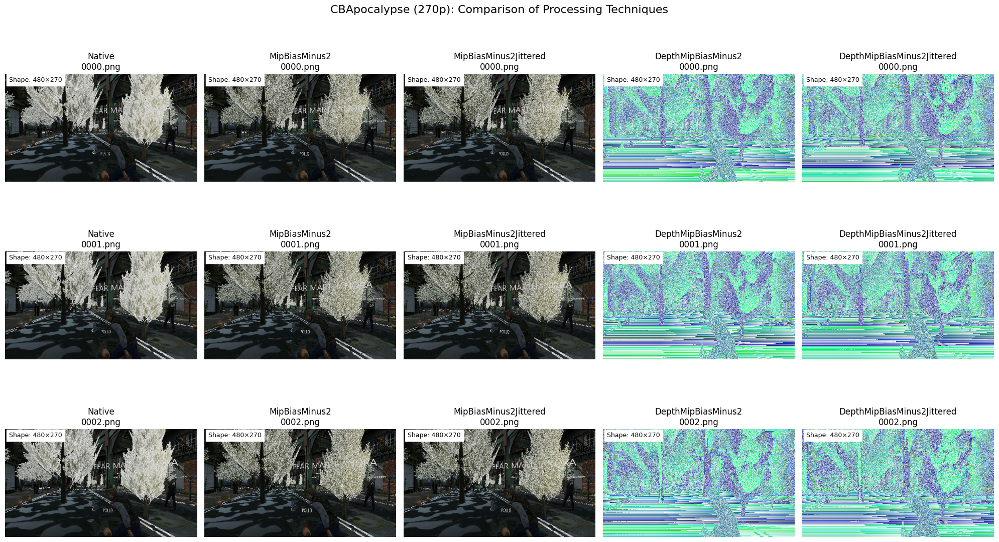


--------------------------------------------------
Analyzing scene: FloodedGrounds
Comparing processing techniques for scene: FloodedGrounds (Resolution: 270p)
  Native: 630 images
  MipBiasMinus2: 630 images
  MipBiasMinus2Jittered: 630 images
  DepthMipBiasMinus2: 630 images
  DepthMipBiasMinus2Jittered: 630 images
  Found 30 matching image pairs across processing techniques


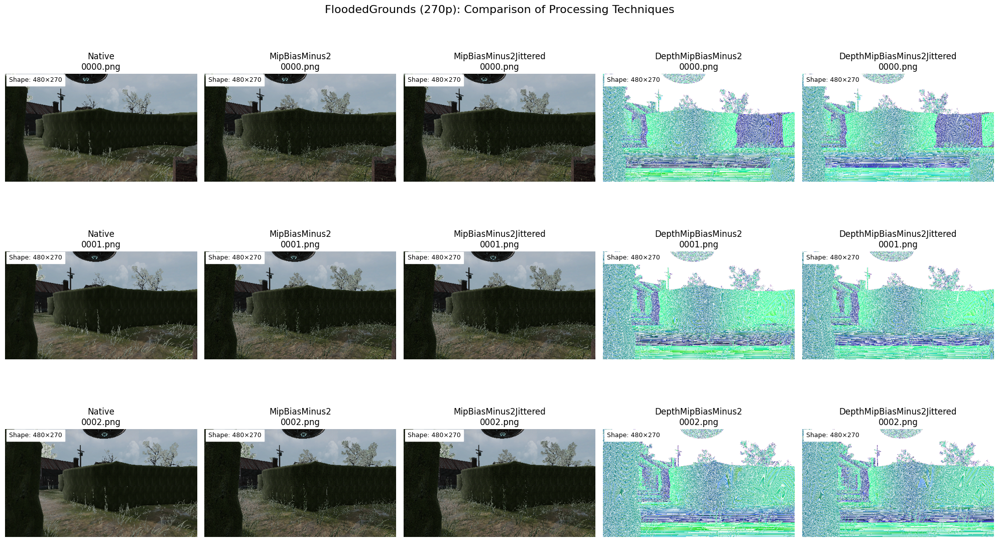


--------------------------------------------------
Analyzing scene: FloodedGroundsBridges
Comparing processing techniques for scene: FloodedGroundsBridges (Resolution: 270p)
  Native: 600 images
  MipBiasMinus2: 600 images
  MipBiasMinus2Jittered: 600 images
  DepthMipBiasMinus2: 600 images
  DepthMipBiasMinus2Jittered: 600 images
  Found 30 matching image pairs across processing techniques


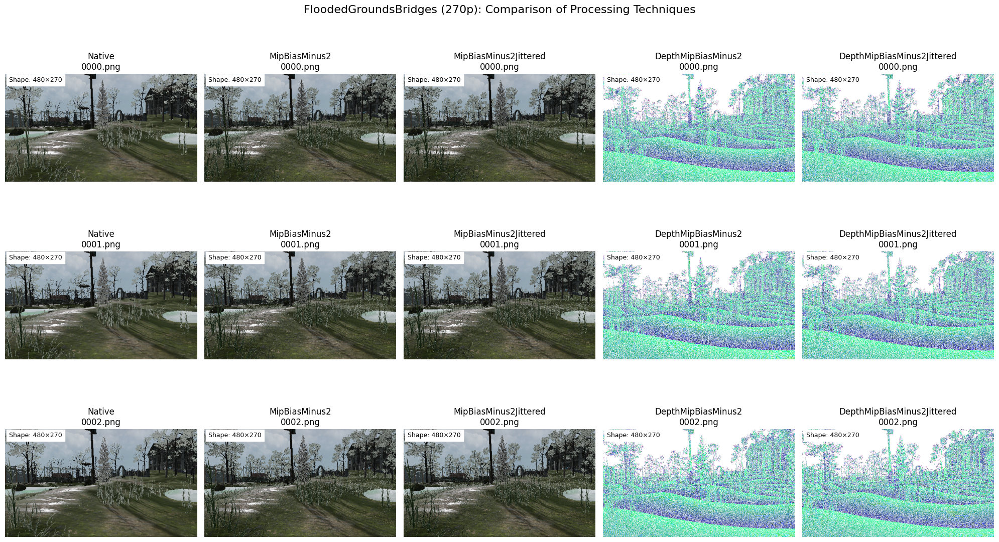


--------------------------------------------------
Analyzing scene: ScifiBase
Comparing processing techniques for scene: ScifiBase (Resolution: 270p)
  Native: 1230 images
  MipBiasMinus2: 1230 images
  MipBiasMinus2Jittered: 1230 images
  DepthMipBiasMinus2: 1230 images
  DepthMipBiasMinus2Jittered: 1230 images
  Found 30 matching image pairs across processing techniques


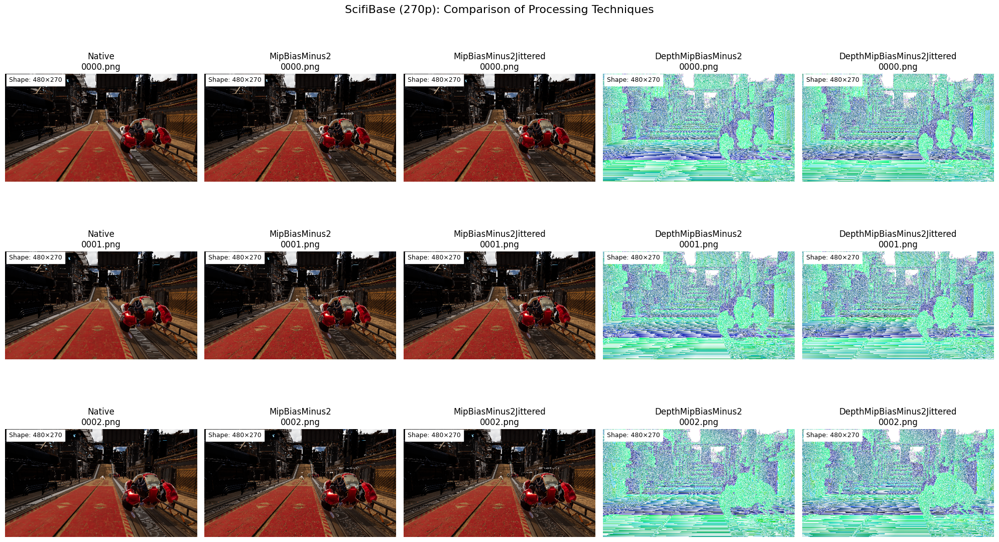


--------------------------------------------------
Analyzing scene: ScifiBaseNightStartStop
Comparing processing techniques for scene: ScifiBaseNightStartStop (Resolution: 270p)
  Native: 600 images
  MipBiasMinus2: 600 images
  MipBiasMinus2Jittered: 600 images
  DepthMipBiasMinus2: 600 images
  DepthMipBiasMinus2Jittered: 600 images
  Found 30 matching image pairs across processing techniques


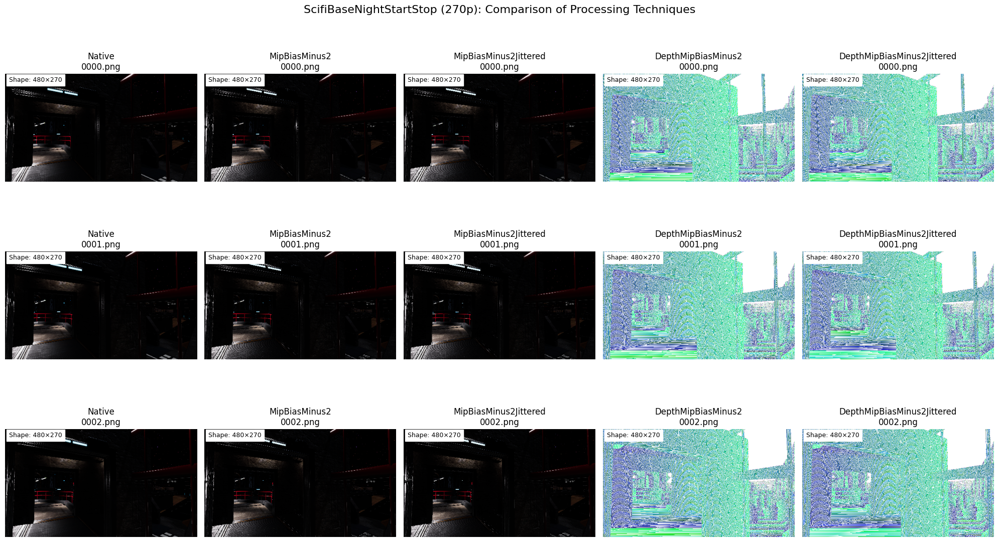


--------------------------------------------------
Analyzing scene: TestSet/AbandonedSchool
Comparing processing techniques for scene: TestSet/AbandonedSchool (Resolution: 270p)
  Native: 600 images
  MipBiasMinus2: 600 images
  MipBiasMinus2Jittered: 600 images
  DepthMipBiasMinus2: 600 images
  DepthMipBiasMinus2Jittered: 600 images
  Found 300 matching image pairs across processing techniques


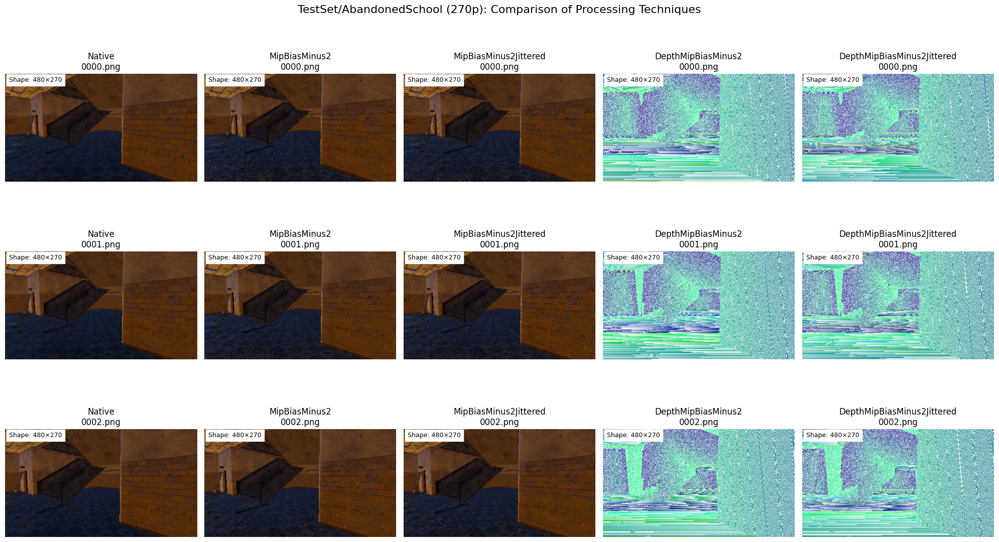


--------------------------------------------------
Analyzing scene: TestSet/Seaport
Comparing processing techniques for scene: TestSet/Seaport (Resolution: 270p)
  Native: 300 images
  MipBiasMinus2: 300 images
  MipBiasMinus2Jittered: 300 images
  DepthMipBiasMinus2: 300 images
  DepthMipBiasMinus2Jittered: 300 images
  Found 300 matching image pairs across processing techniques


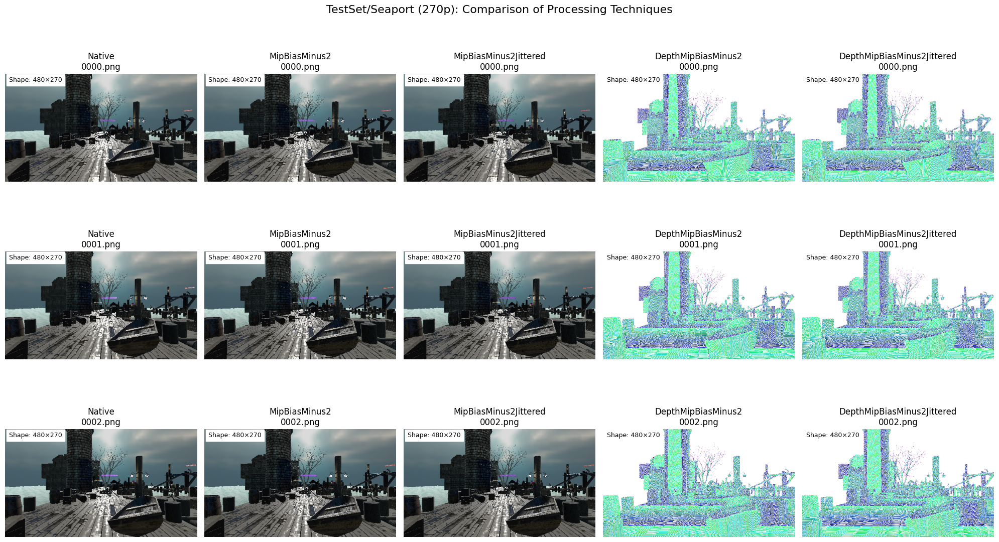


--------------------------------------------------
Analyzing scene: Testset/SpaceShipDemo
Comparing processing techniques for scene: Testset/SpaceShipDemo (Resolution: 270p)
  Native: 600 images
  MipBiasMinus2: 600 images
  MipBiasMinus2Jittered: 600 images
  DepthMipBiasMinus2: 600 images
  DepthMipBiasMinus2Jittered: 600 images
  Found 300 matching image pairs across processing techniques


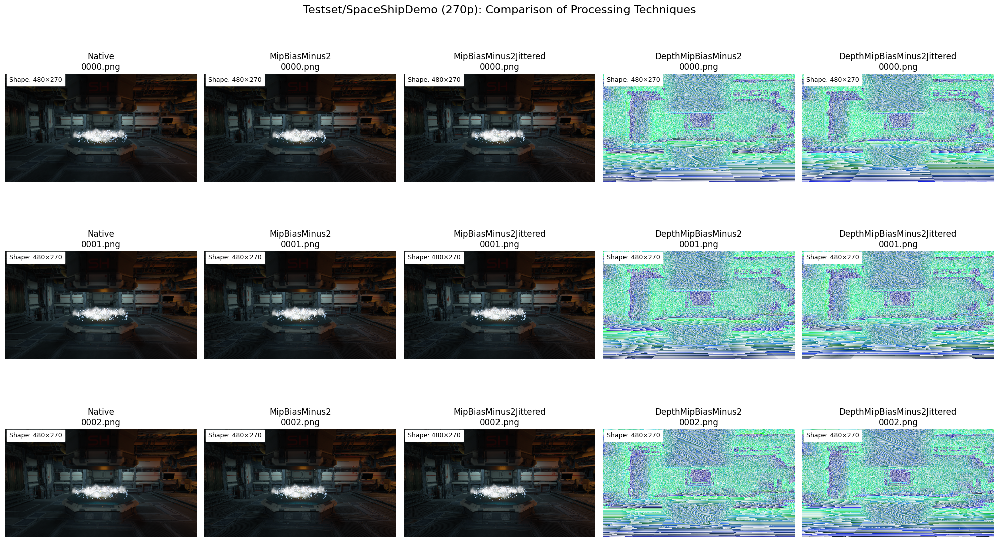

In [48]:
scene_name =['CBApocalypse', 'FloodedGrounds', 'FloodedGroundsBridges', 'ScifiBase', 'ScifiBaseNightStartStop', 'TestSet/AbandonedSchool', 'TestSet/Seaport', 'Testset/SpaceShipDemo'] 
compare_processing_techniques(scene_name, resolution="270p")

## Insights


### Resolution Distribution
|Resolution|	Image Count|
|---------|------------|
|270p|	43,800|
|360p|	8,760|
|540p|	8,760|
|1080p| 8,760|
|Total| 70,080|

There's a heavy emphasis on 270p resolution, which comprises 62.5% of the total dataset. The other resolutions (360p, 540p, and 1080p) each make up only 12.5% of the dataset. This skew toward lower resolution could be deliberate for training super-resolution models

### Dataset Split
|Scene Type|	Image Count|
|---------|------------|
|Test Set|	12,000|
|Train Set|	58,080|

The train-test split is approximately 83%-17%, which is more heavily weighted toward training data than the typical 80/20 split.

### Scale Factors
- The dataset provides consistent 4x upscaling from 270p to 1080p
- Intermediate resolutions (360p, 540p) allow for training at 1.33x and 2x scales
- Model architecture should be designed for these specific scale factors

### Processing Variations
- MipBias versions provide alternative low-resolution inputs that simulate different downsampling techniques
- Jittered versions simulate camera movement/shake and can improve model robustness
- Depth processing techniques add a depth map displaying how far each pixel is from the camera: brighter pixels are closer to the camera and darker pixels are further away
- Training with multiple processing types may yield more robust models